# Geospatial Data Test


# IMPORT LIBRARIES

In [1]:
#pip install nominatim

In [2]:
from geopy.geocoders import Nominatim
import time
from pprint import pprint

Link to interactive map: https://nbviewer.org/github/jglass3/main/blob/aed095a51cdd8950b298248d16a3ed161dd46f63/JupyterNotebook_Data-Science/Geospatial%20Data%2C%20Toledo%20Area%20Limited%20%281%29.ipynb


# LOAD AND PREPARE DATA


## Data Source


Run geospatial on Toledo test data

In [9]:
import pandas as pd
import census_geocoder as geocoder

df = pd.read_csv("10kVoterDataResults.csv")
df.head()

,Unique ID,Address,Match,Exact,Address2,Longitude,Latitude,Unknown 1,Unknown 2,Unknown 3,Unknown 4,Unknown 5,Unknown 6
0,17288,"2015 AIRPORT HWY, TOLEDO, OH, 43609",Match,Exact,"2015 AIRPORT HWY, TOLEDO, OH, 43609",-83.592602,41.632515,33937924.0,L,39.0,95.0,3901.0,1005.0
1,17289,"3700 LILY DR, OREGON, OH, 43616",Match,Exact,"3700 LILY DR, OREGON, OH, 43616",-83.459871,41.641320,609938634.0,L,39.0,95.0,9901.0,1000.0
2,17284,"5564 STEFFENS AVE, TOLEDO, OH, 43623",Match,Non_Exact,"5564 STEFFINS AVE, TOLEDO, OH, 43623",-83.640514,41.716248,33931086.0,R,39.0,95.0,7903.0,2005.0
3,17285,"741 MAIN ST, TOLEDO, OH, 43605",Match,Exact,"741 MAIN ST, TOLEDO, OH, 43605",-83.518222,41.642483,33945437.0,L,39.0,95.0,4800.0,2007.0
4,17286,"642 SWEETWATER DR, OREGON, OH, 43616",Match,Exact,"642 SWEETWATER DR, OREGON, OH, 43616",-83.450067,41.638634,33958507.0,L,39.0,95.0,9901.0,1000.0


#1 — We first delay our Geocoding 1 second between each address. This is convenient when you are Geocoding a large number of physical addresses as the Geocoding service provider can deny access to the service.

#2 — Create a df['location'] column by applying geocode we created.

#3 — Third, we can create latitude, longitude, and altitude as a single tuple column.

#4 — Finally, We split latitude, longitude, and altitude columns into three separate columns.

In [13]:
##Clean up the data by dropping unwanted values
#'Address', 'City', 'State', 'Zip','PHONE','point', 'location'
#df = df.drop(['Name','Address', 'City', 'State', 'Zip','PHONE','point', 'location'], axis=1)

#Method 1: drop any NAN values from the dataframe
#df = df.dropna(axis='columns', how ='all')

#Method 2: drop any NAN values from the dataframe
df = df.dropna(subset=['Longitude', 'Latitude'])


df.head()

,Unique ID,Address,Match,Exact,Address2,Longitude,Latitude,Unknown 1,Unknown 2,Unknown 3,Unknown 4,Unknown 5,Unknown 6
0,17288,"2015 AIRPORT HWY, TOLEDO, OH, 43609",Match,Exact,"2015 AIRPORT HWY, TOLEDO, OH, 43609",-83.592602,41.632515,33937924.0,L,39.0,95.0,3901.0,1005.0
1,17289,"3700 LILY DR, OREGON, OH, 43616",Match,Exact,"3700 LILY DR, OREGON, OH, 43616",-83.459871,41.641320,609938634.0,L,39.0,95.0,9901.0,1000.0
2,17284,"5564 STEFFENS AVE, TOLEDO, OH, 43623",Match,Non_Exact,"5564 STEFFINS AVE, TOLEDO, OH, 43623",-83.640514,41.716248,33931086.0,R,39.0,95.0,7903.0,2005.0
3,17285,"741 MAIN ST, TOLEDO, OH, 43605",Match,Exact,"741 MAIN ST, TOLEDO, OH, 43605",-83.518222,41.642483,33945437.0,L,39.0,95.0,4800.0,2007.0
4,17286,"642 SWEETWATER DR, OREGON, OH, 43616",Match,Exact,"642 SWEETWATER DR, OREGON, OH, 43616",-83.450067,41.638634,33958507.0,L,39.0,95.0,9901.0,1000.0


In [15]:
#data visualization tool 
import folium

In [16]:
map1 = folium.Map(
    location=[41.66,-83.5],
    #light background
    #tiles='cartodbpositron',
    #tiles='CartoDB dark_matter',
    zoom_start=12,
    
)

df.apply(lambda row:folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius = 1, color='Red').add_to(map1), axis=1)
map1

In [17]:
#Code from https://towardsdatascience.com/clustering-geospatial-data-f0584f0b04ec
#modified to fit current data
#
## for data
import numpy as np
import pandas as pd
## for plotting
import matplotlib.pyplot as plt
import seaborn as sns
## for geospatial
import folium
import geopy
## for machine learning
from sklearn import preprocessing, cluster
import scipy

In [20]:
k = 7
model = cluster.KMeans(n_clusters=k, init='k-means++')
X = df[["Latitude","Longitude"]]
## clustering
df_X = X.copy()
df_X["cluster"] = model.fit_predict(X)
## find real centroids
closest, distances = scipy.cluster.vq.vq(model.cluster_centers_, 
                     df_X.drop("cluster", axis=1).values)
df_X["centroids"] = 0
for i in closest:
    df_X["centroids"].iloc[i] = 1
## add clustering info to the original dataset
df[["cluster","centroids"]] = df_X[["cluster","centroids"]]

#drop outliers 
df = df[df.Longitude > -90]

df.head()

C:\Users\T8367J1\AppData\Local\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\T8367J1\AppData\Local\Temp\ipykernel_67920\2705200360.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_X["centroids"].iloc[i] = 1


,Unique ID,Address,Match,Exact,Address2,Longitude,Latitude,Unknown 1,Unknown 2,Unknown 3,Unknown 4,Unknown 5,Unknown 6,cluster,centroids
0,17288,"2015 AIRPORT HWY, TOLEDO, OH, 43609",Match,Exact,"2015 AIRPORT HWY, TOLEDO, OH, 43609",-83.592602,41.632515,33937924.0,L,39.0,95.0,3901.0,1005.0,0,0
1,17289,"3700 LILY DR, OREGON, OH, 43616",Match,Exact,"3700 LILY DR, OREGON, OH, 43616",-83.459871,41.641320,609938634.0,L,39.0,95.0,9901.0,1000.0,4,0
2,17284,"5564 STEFFENS AVE, TOLEDO, OH, 43623",Match,Non_Exact,"5564 STEFFINS AVE, TOLEDO, OH, 43623",-83.640514,41.716248,33931086.0,R,39.0,95.0,7903.0,2005.0,2,0
3,17285,"741 MAIN ST, TOLEDO, OH, 43605",Match,Exact,"741 MAIN ST, TOLEDO, OH, 43605",-83.518222,41.642483,33945437.0,L,39.0,95.0,4800.0,2007.0,4,0
4,17286,"642 SWEETWATER DR, OREGON, OH, 43616",Match,Exact,"642 SWEETWATER DR, OREGON, OH, 43616",-83.450067,41.638634,33958507.0,L,39.0,95.0,9901.0,1000.0,4,0


<Axes: xlabel='Longitude', ylabel='Latitude'>

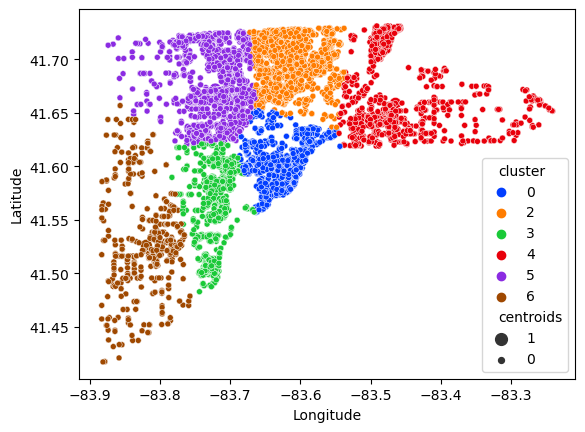

In [21]:
## plot
fig, ax = plt.subplots()

sns.scatterplot(y="Latitude", x="Longitude", data=df, 
                palette=sns.color_palette("bright",6),
                hue='cluster', size="centroids", size_order=[1,0],
                ax=ax) #removed legend legend="brief"


#th_centroids = model.cluster_centers_
#ax.scatter(th_centroids[:,0], th_centroids[:,1], s=50, c='black', 
          #marker="x")
    

In [22]:

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors


map_clusters = folium.Map(location=[41.66,-83.5], zoom_start=10)

# set color scheme for the clusters, generates list of colors
#x = np.arange(6)
#ys = [i + x + (i*x)**2 for i in range(6)]
#colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
#rainbow = [colors.rgb2hex(i) for i in colors_array]

rainbow = ['#8000ff', '#1928f3', '#071c18', '#b51105', '#804d01', '#276b63']

# add markers to the map
markers_colors = []
for lat, lng, cluster, address in zip(df['Latitude'], df['Longitude'], df['cluster'], df['Address2']):
    folium.vector_layers.CircleMarker(
        [lat, lng],
        radius=1,
        #popup=label,
        tooltip = str(address),
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters